In [1]:
%matplotlib inline
import matplotlib.pyplot as plt
import os
import glob
import zarr
import numpy as np
import json
import cv2
from copy import deepcopy

In [2]:
folder_data = '/home/olli/Projects/Kaggle/CryoET/Data'

In [3]:
folder_train_data = os.path.join(folder_data, 'train', 'static', 'ExperimentRuns')

In [4]:
os.listdir(folder_train_data)

['TS_5_4', 'TS_6_6', 'TS_99_9', 'TS_73_6', 'TS_86_3', 'TS_6_4', 'TS_69_2']

#### 7 samples

In [5]:
samples = os.listdir(folder_train_data)

In [6]:
path_example = os.path.join(folder_train_data, samples[0], 'VoxelSpacing10.000', 'denoised.zarr')

#### Size of one sample (denoised in test only)

In [7]:
!du -h $path_example

4,6M	/home/olli/Projects/Kaggle/CryoET/Data/train/static/ExperimentRuns/TS_5_4/VoxelSpacing10.000/denoised.zarr/2/0/0
4,6M	/home/olli/Projects/Kaggle/CryoET/Data/train/static/ExperimentRuns/TS_5_4/VoxelSpacing10.000/denoised.zarr/2/0
4,6M	/home/olli/Projects/Kaggle/CryoET/Data/train/static/ExperimentRuns/TS_5_4/VoxelSpacing10.000/denoised.zarr/2
6,9M	/home/olli/Projects/Kaggle/CryoET/Data/train/static/ExperimentRuns/TS_5_4/VoxelSpacing10.000/denoised.zarr/1/0/1
28M	/home/olli/Projects/Kaggle/CryoET/Data/train/static/ExperimentRuns/TS_5_4/VoxelSpacing10.000/denoised.zarr/1/0/0
35M	/home/olli/Projects/Kaggle/CryoET/Data/train/static/ExperimentRuns/TS_5_4/VoxelSpacing10.000/denoised.zarr/1/0
35M	/home/olli/Projects/Kaggle/CryoET/Data/train/static/ExperimentRuns/TS_5_4/VoxelSpacing10.000/denoised.zarr/1
50M	/home/olli/Projects/Kaggle/CryoET/Data/train/static/ExperimentRuns/TS_5_4/VoxelSpacing10.000/denoised.zarr/0/0/2
106M	/home/olli/Projects/Kaggle/CryoET/Data/train/static/ExperimentRuns/

#### load the example

In [8]:
exp = zarr.open(path_example, mode='r')

#### All 7 samples have 3 dimensions

In [9]:
exp[0].shape

(184, 630, 630)

In [10]:
exp[1].shape

(92, 315, 315)

In [11]:
exp[2].shape

(46, 158, 158)

#### Check the all different sample shapes

In [12]:
for sample in samples:
    path_sample = os.path.join(folder_train_data, sample, 'VoxelSpacing10.000', 'denoised.zarr')
    sample_array = zarr.open(path_sample, mode='r')
    print(f'Sample: {sample}')
    print(f'Shape 0: {sample_array[0].shape}; Shape 1: {sample_array[1].shape}; Shape 2: {sample_array[2].shape}\n')

Sample: TS_5_4
Shape 0: (184, 630, 630); Shape 1: (92, 315, 315); Shape 2: (46, 158, 158)

Sample: TS_6_6
Shape 0: (184, 630, 630); Shape 1: (92, 315, 315); Shape 2: (46, 158, 158)

Sample: TS_99_9
Shape 0: (184, 630, 630); Shape 1: (92, 315, 315); Shape 2: (46, 158, 158)

Sample: TS_73_6
Shape 0: (184, 630, 630); Shape 1: (92, 315, 315); Shape 2: (46, 158, 158)

Sample: TS_86_3
Shape 0: (184, 630, 630); Shape 1: (92, 315, 315); Shape 2: (46, 158, 158)

Sample: TS_6_4
Shape 0: (184, 630, 630); Shape 1: (92, 315, 315); Shape 2: (46, 158, 158)

Sample: TS_69_2
Shape 0: (184, 630, 630); Shape 1: (92, 315, 315); Shape 2: (46, 158, 158)



#### Same shapes; dim 1 & 2 are just lower res

#### Plot some of the slices along the z-dim (y, x)

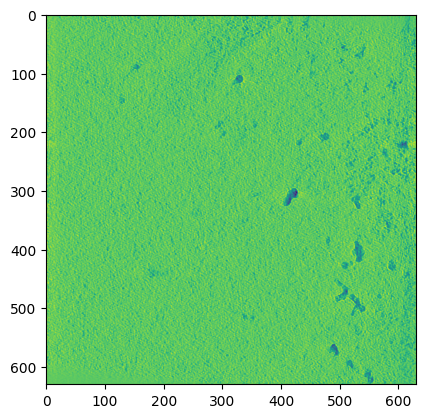

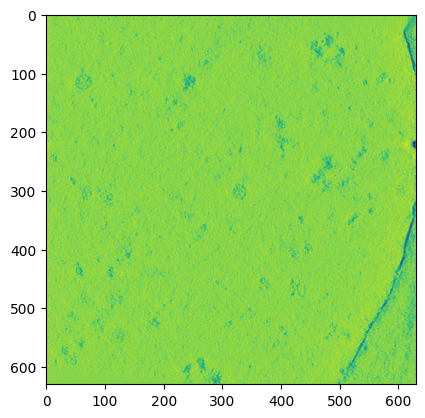

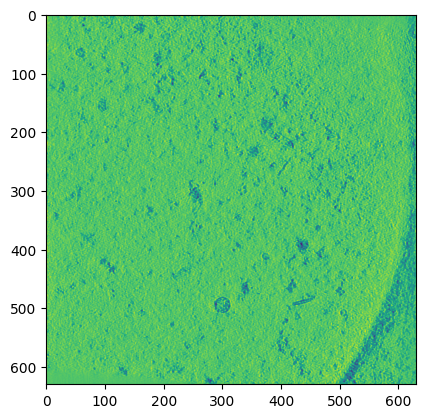

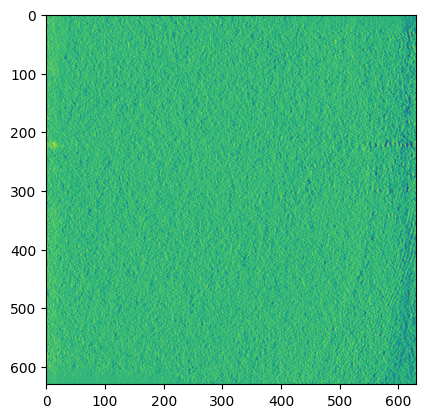

In [13]:
for i in range(0, exp[0].shape[0], 60):
    img = exp[0][i, :, :]
    plt.imshow(img)
    plt.show()

#### Now load the labels for the example

In [14]:
folder_labels = '/home/olli/Projects/Kaggle/CryoET/Data/train/overlay/ExperimentRuns'

In [15]:
path_example_label = os.path.join(folder_labels, samples[0], 'Picks')

In [16]:
os.listdir(path_example_label)

['virus-like-particle.json',
 'ribosome.json',
 'thyroglobulin.json',
 'apo-ferritin.json',
 'beta-galactosidase.json',
 'beta-amylase.json']

#### Each class has its own json file - beta-amylase not scored

In [17]:
def load_json(sample, class_):

    path_json = os.path.join(folder_labels, sample, 'Picks', f'{class_}.json')

    with open(path_json, 'r') as f:
        label = json.load(f)

    return label

In [18]:
label_ribosome = load_json(samples[0], 'ribosome')

In [19]:
label_ribosome

{'pickable_object_name': 'ribosome',
 'user_id': 'curation',
 'session_id': '0',
 'run_name': 'TS_5_4',
 'voxel_spacing': None,
 'unit': 'angstrom',
 'points': [{'location': {'x': 4601.271, 'y': 601.066, 'z': 600.934},
   'transformation_': [[1.0, 0.0, 0.0, 0.0],
    [0.0, 1.0, 0.0, 0.0],
    [0.0, 0.0, 1.0, 0.0],
    [0.0, 0.0, 0.0, 1.0]],
   'instance_id': 0},
  {'location': {'x': 4803.789, 'y': 455.425, 'z': 514.016},
   'transformation_': [[1.0, 0.0, 0.0, 0.0],
    [0.0, 1.0, 0.0, 0.0],
    [0.0, 0.0, 1.0, 0.0],
    [0.0, 0.0, 0.0, 1.0]],
   'instance_id': 0},
  {'location': {'x': 4715.436, 'y': 825.374, 'z': 802.166},
   'transformation_': [[1.0, 0.0, 0.0, 0.0],
    [0.0, 1.0, 0.0, 0.0],
    [0.0, 0.0, 1.0, 0.0],
    [0.0, 0.0, 0.0, 1.0]],
   'instance_id': 0},
  {'location': {'x': 5003.275, 'y': 782.745, 'z': 802.48},
   'transformation_': [[1.0, 0.0, 0.0, 0.0],
    [0.0, 1.0, 0.0, 0.0],
    [0.0, 0.0, 1.0, 0.0],
    [0.0, 0.0, 0.0, 1.0]],
   'instance_id': 0},
  {'location': {'x

#### The labels have a different scale; get the specific factor since its not exactly 10

In [20]:
print(dict(exp.attrs))

{'multiscales': [{'axes': [{'name': 'z', 'type': 'space', 'unit': 'angstrom'}, {'name': 'y', 'type': 'space', 'unit': 'angstrom'}, {'name': 'x', 'type': 'space', 'unit': 'angstrom'}], 'datasets': [{'coordinateTransformations': [{'scale': [10.012444196428572, 10.012444196428572, 10.012444537618887], 'type': 'scale'}], 'path': '0'}, {'coordinateTransformations': [{'scale': [20.024888392857143, 20.024888392857143, 20.024889075237773], 'type': 'scale'}], 'path': '1'}, {'coordinateTransformations': [{'scale': [40.049776785714286, 40.049776785714286, 40.04977815047555], 'type': 'scale'}], 'path': '2'}], 'metadata': {}, 'name': '/', 'version': '0.4'}]}


In [21]:
exp.attrs['multiscales'][0]

{'axes': [{'name': 'z', 'type': 'space', 'unit': 'angstrom'},
  {'name': 'y', 'type': 'space', 'unit': 'angstrom'},
  {'name': 'x', 'type': 'space', 'unit': 'angstrom'}],
 'datasets': [{'coordinateTransformations': [{'scale': [10.012444196428572,
      10.012444196428572,
      10.012444537618887],
     'type': 'scale'}],
   'path': '0'},
  {'coordinateTransformations': [{'scale': [20.024888392857143,
      20.024888392857143,
      20.024889075237773],
     'type': 'scale'}],
   'path': '1'},
  {'coordinateTransformations': [{'scale': [40.049776785714286,
      40.049776785714286,
      40.04977815047555],
     'type': 'scale'}],
   'path': '2'}],
 'metadata': {},
 'name': '/',
 'version': '0.4'}

In [22]:
exp.attrs['multiscales'][0]['datasets'][0]['coordinateTransformations'][0]['scale']

[10.012444196428572, 10.012444196428572, 10.012444537618887]

#### scales for z, y, x

In [23]:
scales_exp = exp.attrs['multiscales'][0]['datasets'][0]['coordinateTransformations'][0]['scale']

In [24]:
label_ribosome['points'][0]['location']

{'x': 4601.271, 'y': 601.066, 'z': 600.934}

In [25]:
exp_label_ribosom = label_ribosome['points'][0]['location']

In [26]:
exp_x = exp_label_ribosom['x'] / scales_exp[2]
exp_y = exp_label_ribosom['y'] / scales_exp[1]
exp_z = exp_label_ribosom['z'] / scales_exp[0]

In [27]:
print(exp_x, exp_y, exp_z)

459.5552047965953 60.03189513050167 60.018711536425094


#### now get the slice for z=60 and plot x&y

In [28]:
exp_slice = exp[0][int(exp_z), :, :]

In [29]:
exp_slice.shape  # y, x

(630, 630)

#### Ribosom radius is 150 so a prediction in half of that is considered correct -> mark the circle (green)

In [30]:
img = cv2.cvtColor(deepcopy(exp_slice), cv2.COLOR_GRAY2BGR)  # pixel number are super low so scare it for plotting
img = (img - img.min()) / (img.max() - img.min())  # 0-1
img = cv2.circle(img, (int(exp_x), int(exp_y)), int(75 / 10), (0, 1, 0), 1)
img = cv2.circle(img, (int(exp_x), int(exp_y)), 1, (0, 0, 1), -1)

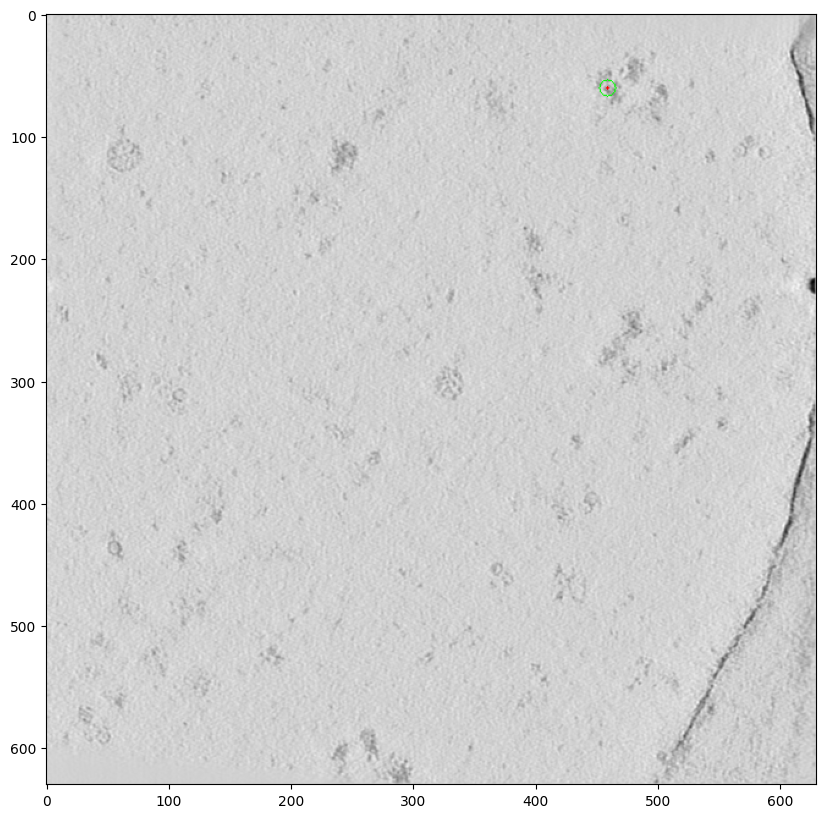

In [31]:
fig = plt.figure(figsize=(10, 10))
plt.imshow(img[:,:,::-1])
plt.show()

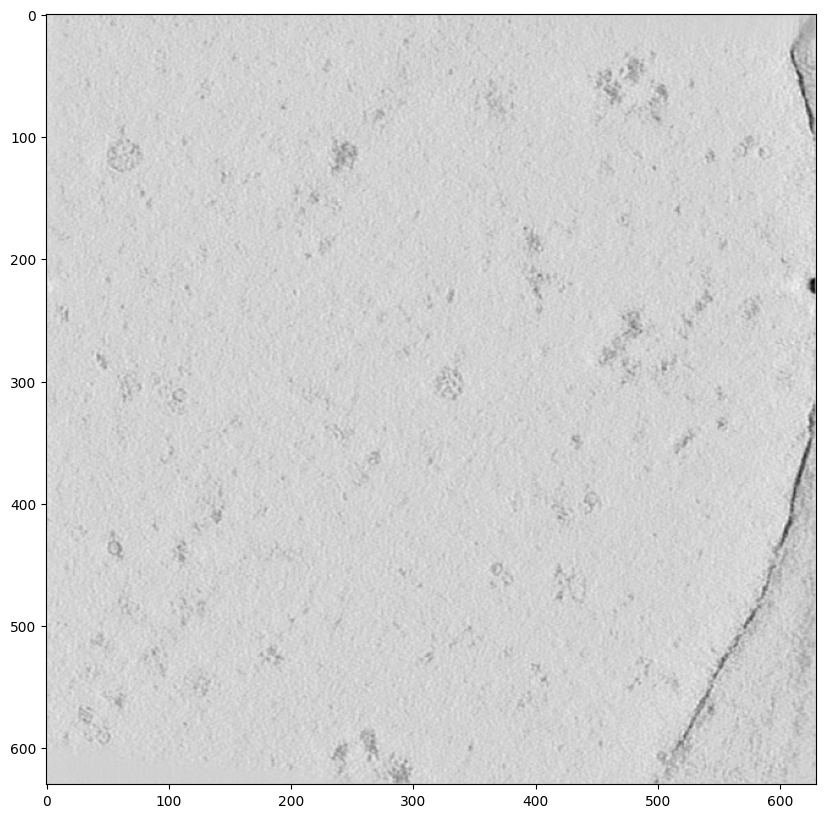

In [32]:
fig = plt.figure(figsize=(10, 10))
plt.imshow(exp_slice, cmap='gray')
plt.show()

#### that is only a 2d slice the correct region is a sphere in 3d

#### Write a generic fuction that show a random ground truth like above

In [33]:
radiuses = {
    'apo_ferritin': 60,
    'beta_amylase': 65,
    'beta_galactosidase': 90,
    'ribosome': 150,
    'thyroglobulin': 130,
    'virus_like_particle': 135,
}

In [34]:
target_filenames = {
    'virus_like_particle': 'virus-like-particle.json',
    'ribosome': 'ribosome.json',
    'thyroglobulin': 'thyroglobulin.json',
    'apo_ferritin': 'apo-ferritin.json',
    'beta_galactosidase': 'beta-galactosidase.json',
    'beta_amylase': 'beta-amylase.json'   
}

In [35]:
folder_test_data = '/home/olli/Projects/Kaggle/CryoET/Data/test'

In [36]:
def plot_random_prediction(sample, target, z=None):
    '''
    Sample is one of 'TS_5_4', 'TS_6_6', 'TS_99_9', 'TS_73_6', 'TS_86_3', 'TS_6_4', 'TS_69_2'
    Target is one of the radiuses keys i.e. apo_ferritin, beta_galactosidase, ...
    Plots a random target from the json in the nearest z-slice and all targets close to it
    If z is specified uses this value instead or the random one
    '''

    path_exp = os.path.join(folder_train_data, sample, 'VoxelSpacing10.000', 'denoised.zarr')

    json_name = target_filenames[target]

    path_label = os.path.join(folder_labels, sample, 'Picks', json_name)

    radius = radiuses[target]

    # load the sample
    exp = zarr.open(path_exp, mode='r')

    # load the json
    with open(path_label, 'r') as f:
        labels = json.load(f)

    scales = exp.attrs['multiscales'][0]['datasets'][0]['coordinateTransformations'][0]['scale']
    z_scale, y_scale, x_scale = scales

    all_points = labels['points']#[0]['location']

    # take a random point
    point = all_points[np.random.randint(len(all_points))]['location']

    if z is None:
        z = point['z']

    x_values, y_values = [], []
    
    x_values.append(point['x'])
    y_values.append(point['y'])

    
    # plot all points in the corresponding slice that should be visible (half radius to z)
    for p in all_points:
        
        loc = p['location']
        z_ = loc['z']
        
        if z_ > (z - radius * 0.5) and z_ < (z + radius * 0.5):

            x_values.append(loc['x'])
            y_values.append(loc['y'])

    # get the z-slice
    img = exp[0][int(z / z_scale), :, :]
    
    img = cv2.cvtColor(deepcopy(img), cv2.COLOR_GRAY2BGR)
    img = (img - img.min()) / (img.max() - img.min())  # 0-1

    # loop over all pints and mark them (mid and target radius for eval)
    for x, y in zip(x_values, y_values):

        img = cv2.circle(img, (int(x / x_scale), int(y / y_scale)), int(radius / 10), (0, 1, 0), 1)  # / 10 because 10A scale
        img = cv2.circle(img, (int(x / x_scale), int(y / y_scale)), 1, (0, 0, 1), -1)
    
    fig = plt.figure(figsize=(7, 7))
    plt.imshow(img[:, :, ::-1])
    plt.title(f'{sample} - {target}')
    plt.axis('off')
    plt.show()

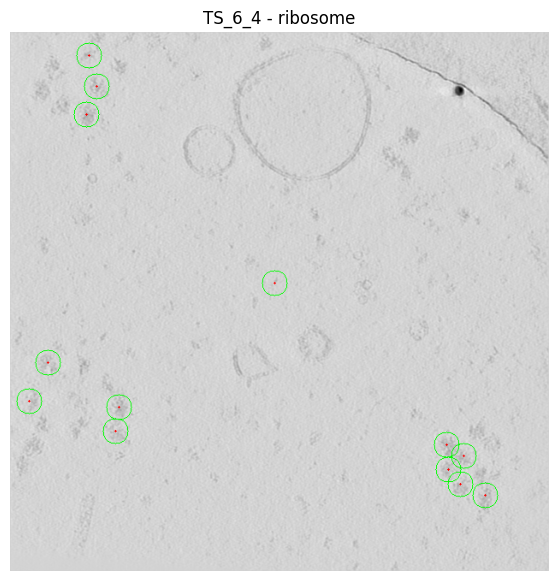

In [37]:
plot_random_prediction('TS_6_4', 'ribosome', z=620)

### Plot some examples for each class

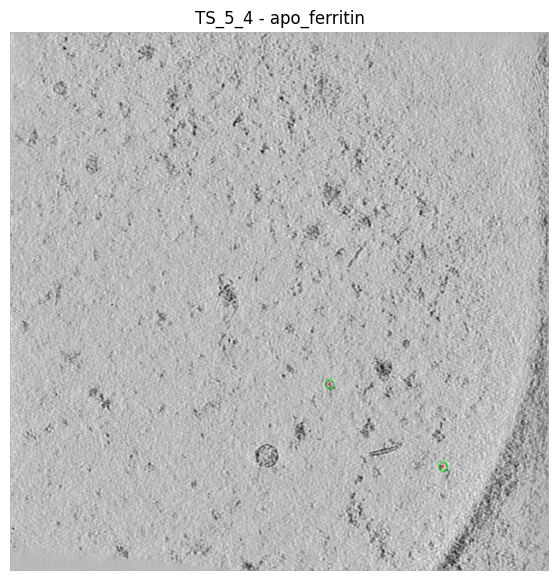

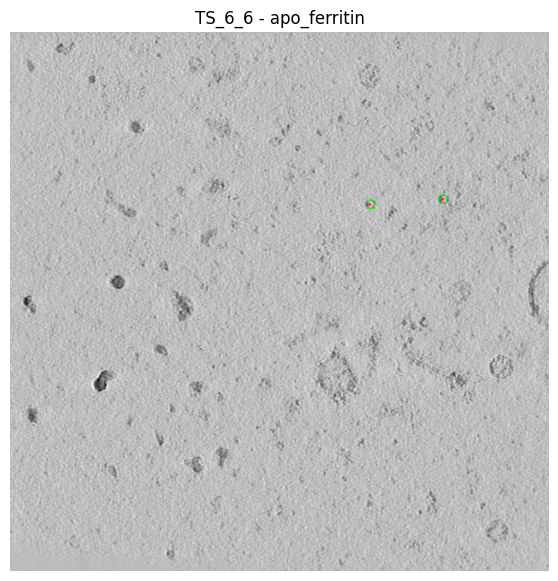

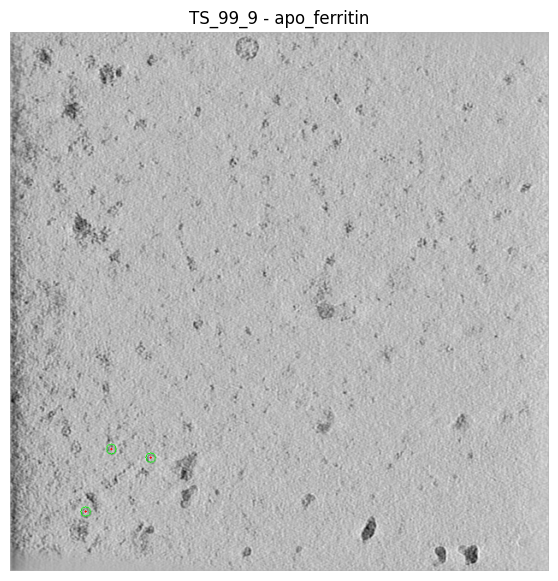

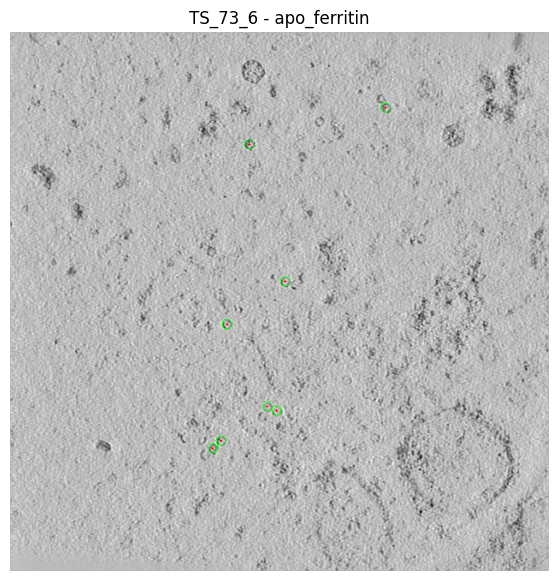

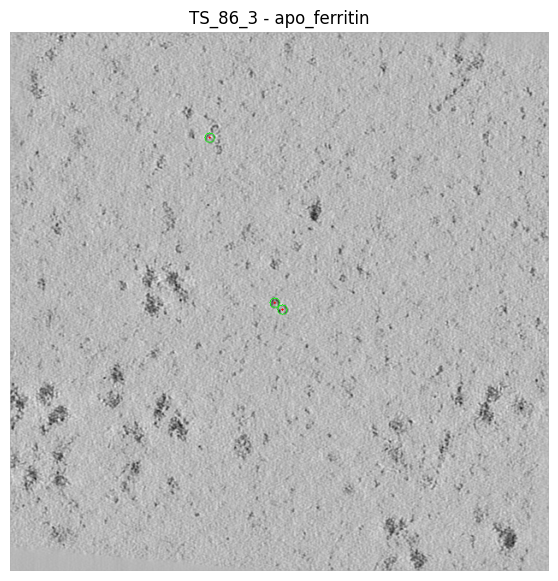

...

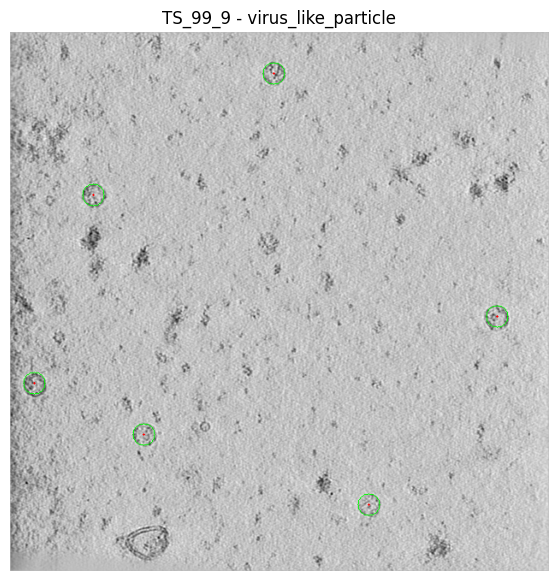

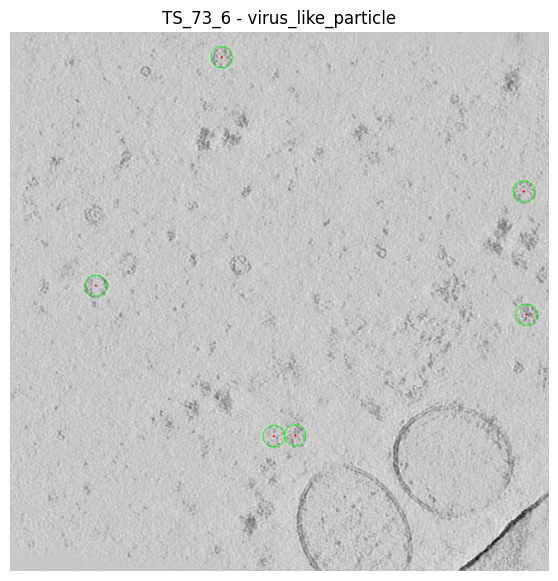

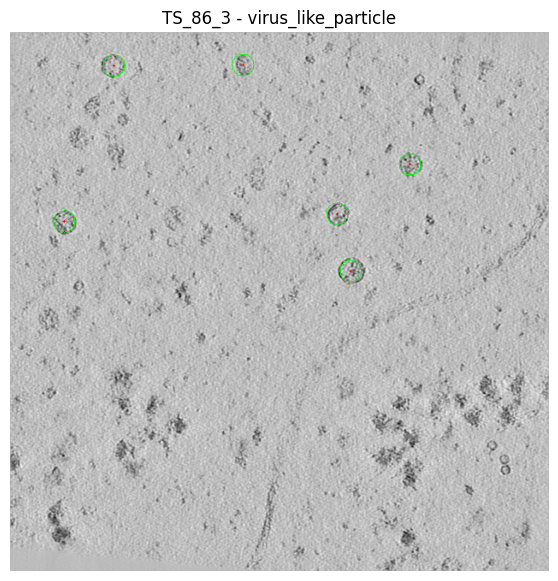

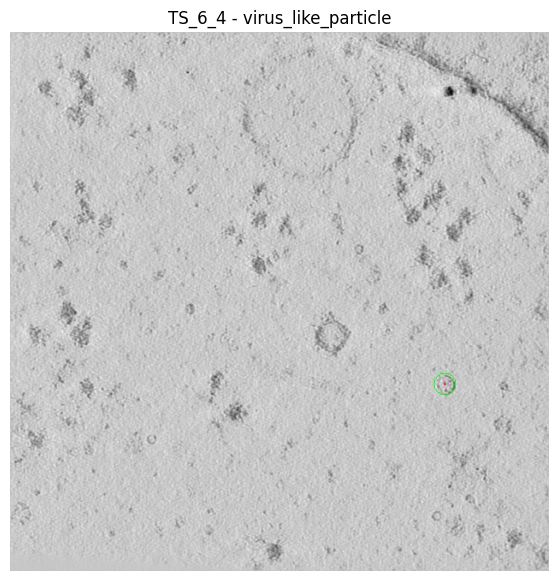

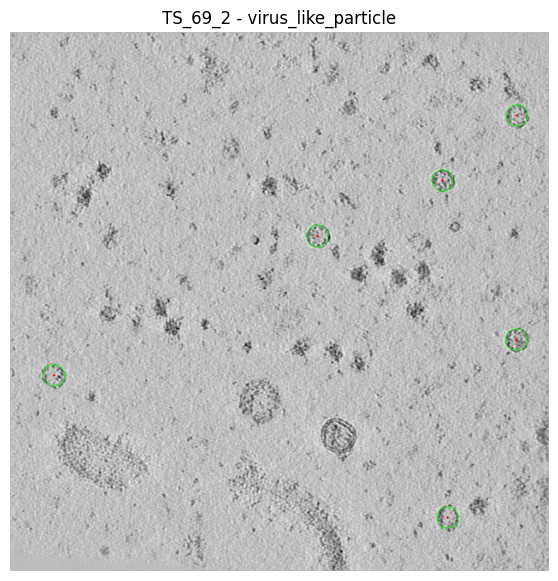

In [38]:
for target in radiuses.keys():
    for sample in samples:
        plot_random_prediction(sample, target)